# 02_Plot_Clustering_Performance

In [2]:
%load_ext autoreload
%autoreload 2

In [3]:
import os
import scanpy as sc
import pandas as pd
import numpy as np
import anndata as ad
import seaborn as sns   

# approximate original figure in http://spatial.libd.org/spatialLIBD/
palette_celltype={'L1':'#eb34a8',
                  'L2':'#3486eb',
                  'L3':'#34eb5b',
                  'L4':"#ae34eb",
                  'L5':'#ebdb34',
                  'L6':'#eb9234',
                  'WM':'#000000'}

palette_entity_anno = palette_celltype.copy()
palette_entity_anno['gene'] = "lightgray"

import simba as si

/data/pinello/SHARED_SOFTWARE/anaconda_latest/envs/cc_envs/cc_simba_only/lib/python3.10/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
tab10_palette = sns.color_palette("tab10", n_colors=10)
leiden_palette = {str(i): tab10_palette[i] for i in range(10)}

In [5]:
si.settings.set_figure_params(
    dpi=80,
    style='white',
    fig_size=[5,5],
    rc={'image.cmap': 'viridis'}
)

from matplotlib_inline.backend_inline import set_matplotlib_formats
set_matplotlib_formats('retina')
import matplotlib.pyplot as plt

In [6]:
from sklearn.metrics import silhouette_score, adjusted_rand_score, normalized_mutual_info_score

In [38]:
from benchmarking.plot import generate_umap_figures, generate_pca_figures, combine_images
from benchmarking.plot import generate_spatial_figures
from benchmarking.cluster import run_leiden_clustering

In [72]:
def cluster_embeddings(
    results_tsv_path, 
    version='normal',
    cell_embedding_adata_fn="adata_C.h5ad",
    adata_spatial_dir="/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/",
    col_name=None,
    parse_path_col=None
):
    """
    results_tsv_path: "<path>/<col_name>.output.tsv"
    """
    # simba_spatial_and_RNA_SCALED_output_fn = "../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/run_simba_spatial_and_rna.output.tsv"
    results_df = pd.read_csv(results_tsv_path, sep='\t', index_col=0)

    path, fn = results_tsv_path.rsplit('/', 1)
    prefix = fn.rsplit('.', 1)[0]
    performance_fn = f"{path}/{prefix}.performance.tsv"
    results_fn = f"{path}/{prefix}.figures.tsv"

    col_name = prefix.split('.')[0] if col_name is None else col_name

    if parse_path_col is not None: # paths go directly to the adata object, rather than /path/sample/...
        results_df[col_name] = results_df[parse_path_col].apply(lambda x: x.rsplit("/", 1)[0])
        print(results_df.head())
    
    run_leiden_clustering(
        adata_output_df=results_df,
        path_col=col_name,
        cell_embedding_adata_fn=cell_embedding_adata_fn, # adata_C, adata_CC, etc.
        performance_output_fn=performance_fn,
        version=version, # PCA, or UMAP
    )
    
    if version == 'normal':
        prefix_cell_embedding_adata_fn = f'leiden.{cell_embedding_adata_fn}'  # e.g. adata_C.h5ad
        results_df = generate_umap_figures(
            results_df, # getting directory
            path_col=col_name,
            fig_path=f'{path}/UMAP_LEIDEN',
            cell_embedding_adata_fn=prefix_cell_embedding_adata_fn,
            adata_color_col='leiden',
            fig_exts=['png'],
            run_umap=True,
            palette=None,
        )
    elif version == 'PCA':
        prefix_cell_embedding_adata_fn = f'PCA.{cell_embedding_adata_fn}'
        results_df = generate_pca_figures(
            results_df, # just gettign directory
            path_col=col_name,
            fig_path=f'{path}/PCA_LEIDEN',
            adata_color_col='leiden',
            fig_exts=['png'],
            cell_embedding_adata_fn=prefix_cell_embedding_adata_fn, # e.g. adata_CG.h5ad
            palette=None,
        )

    results_df = generate_spatial_figures(
        results_df,
        path_col=col_name,
        cell_embedding_adata_fn=prefix_cell_embedding_adata_fn,
        adata_spatial_dir= adata_spatial_dir, # directory with the spatial coordinates.e.g.  <sample_id>.h5ad
        fig_path = f"{path}/LEIDEN_SPATIAL",
        adata_color_col="leiden", # leiden, etc.
        fig_exts=["png"],
        s=10, 
        fig_ncol=1,
        linewidth=0
    )

    results_df.to_csv(results_fn, sep='\t')

    return results_fn, performance_fn

# PCA

In [58]:
pca_fn = "../results/00/pca_rna/run_pca.output.tsv"
pca_figs_fn, pca_performance_fn = cluster_embeddings(pca_fn, cell_embedding_adata_fn='adata_CG.h5ad', version='PCA')

  8%|▊         | 1/12 [00:04<00:45,  4.14s/it]

100%|██████████| 12/12 [00:04<00:00,  2.88it/s]


In [84]:
pca_performance_fn

'../results/00/pca_rna/run_pca.output.performance.tsv'

In [60]:
pca_figs_df = pd.read_csv(pca_figs_fn, sep='\t', index_col=0)
pca_figs_df.head()

,run_pca,pca_fig_png,spatial_fig_png
151675,../results/00/pca_rna/151675,../results/00/pca_rna/PCA_LEIDEN/151675.png,../results/00/pca_rna/LEIDEN_SPATIAL/151675.png
151507,../results/00/pca_rna/151507,../results/00/pca_rna/PCA_LEIDEN/151507.png,../results/00/pca_rna/LEIDEN_SPATIAL/151507.png
151510,../results/00/pca_rna/151510,../results/00/pca_rna/PCA_LEIDEN/151510.png,../results/00/pca_rna/LEIDEN_SPATIAL/151510.png
151674,../results/00/pca_rna/151674,../results/00/pca_rna/PCA_LEIDEN/151674.png,../results/00/pca_rna/LEIDEN_SPATIAL/151674.png
151669,../results/00/pca_rna/151669,../results/00/pca_rna/PCA_LEIDEN/151669.png,../results/00/pca_rna/LEIDEN_SPATIAL/151669.png


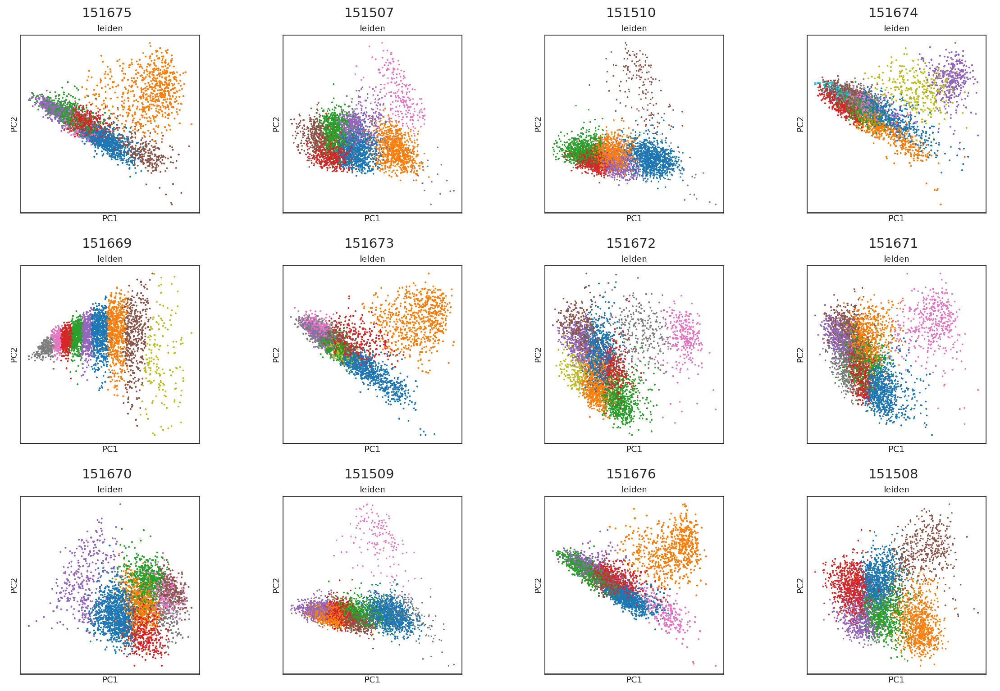

In [61]:
fig, axes = combine_images(
    pca_figs_df, img_path_col='pca_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

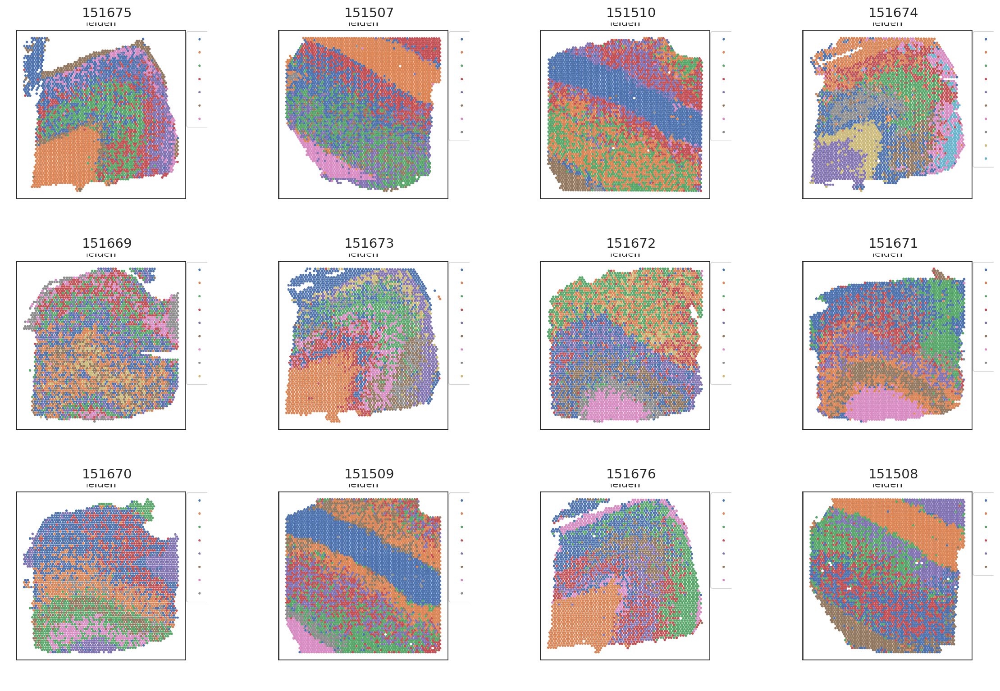

In [62]:
fig, axes = combine_images(
    pca_figs_df, img_path_col='spatial_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

### Ground truth

In [63]:
ground_truth_output_df = generate_spatial_figures(
    pca_figs_df.copy(),
    path_col="run_pca",
    cell_embedding_adata_fn="PCA.adata_CG.h5ad",
    adata_spatial_dir="/data/pinello/PROJECTS/2025-01-31_CC_Spatial_SIMBA/SIMBA_in_space/data/human_DLPFC/", # directory with the spatial coordinates.e.g.  <sample_id>.h5ad
    fig_path = "../results/00/pca_rna/SPATIAL_GROUND_TRUTH",
    adata_color_col="spatialLIBD", # leiden, etc.
    fig_exts=["png"],
    s=10, 
    fig_ncol=1,
    linewidth=0
)

100%|██████████| 12/12 [00:05<00:00,  2.33it/s]


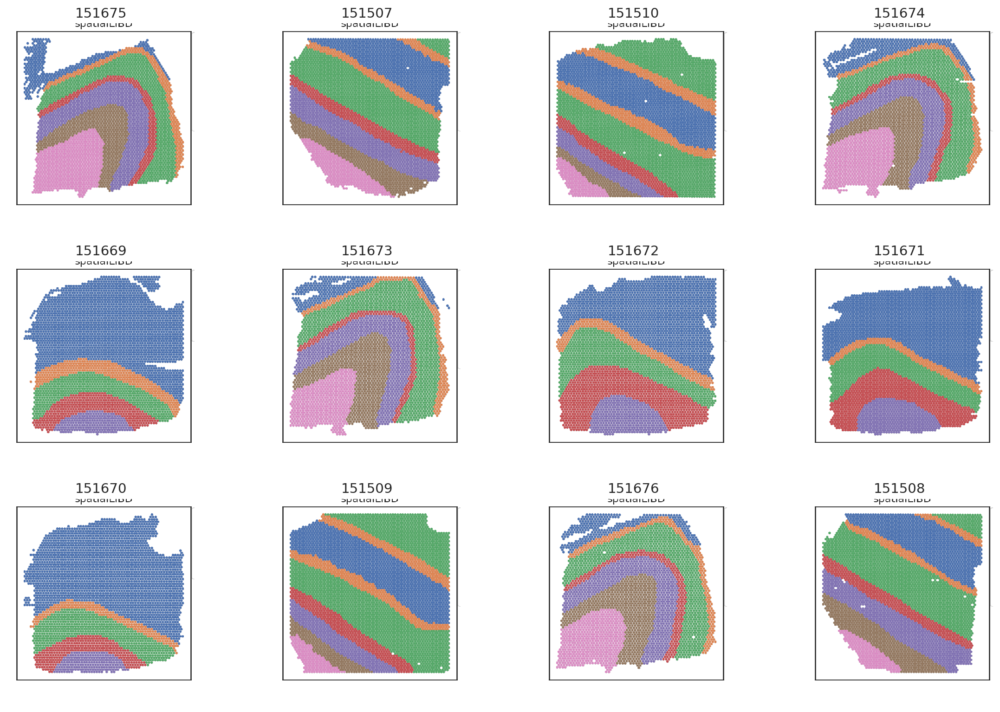

In [64]:
fig, axes = combine_images(
    ground_truth_output_df, img_path_col='spatial_fig_png',
    x_min=50,
    x_max=550,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

# SpatialPCA

In [ ]:
spatialpca_fn = '../results/00/spatialpca/spatialpca_adata_py.tsv'
spatialpca_figs_fn, spatialpca_performance_fn = cluster_embeddings(spatialpca_fn, cell_embedding_adata_fn='spatialPCA_to_py.adata.h5ad', version='PCA', parse_path_col='spatialPCA_adata_fn')

In [83]:
spatialpca_performance_fn

'../results/00/spatialpca/spatialpca_adata_py.performance.tsv'

In [74]:
spatialpca_figs_df = pd.read_csv(spatialpca_figs_fn, sep='\t', index_col=0)

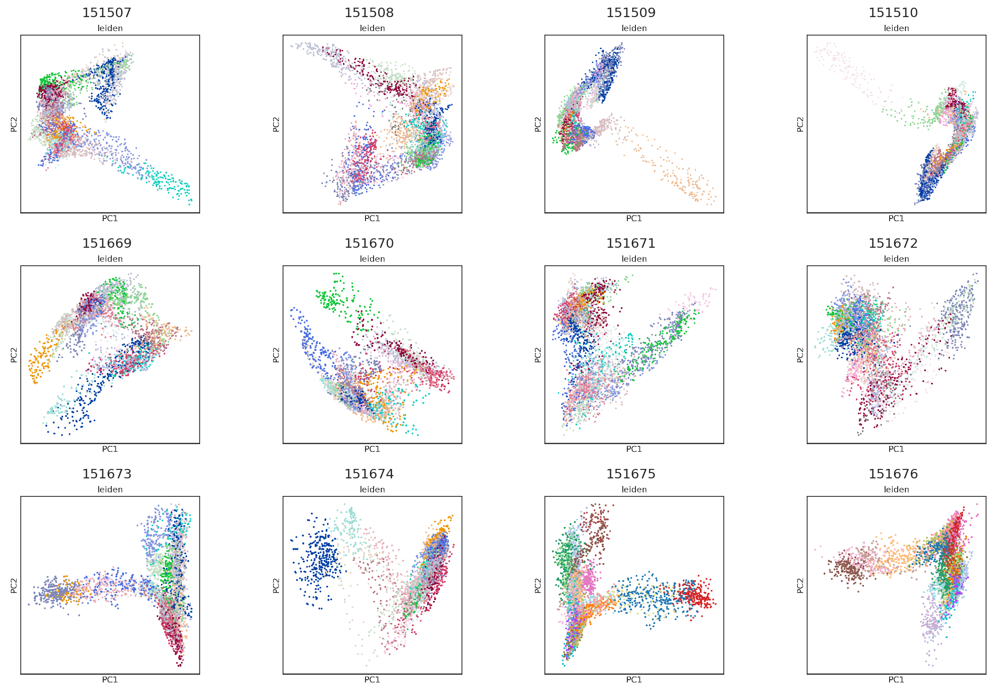

In [75]:
fig, axes = combine_images(
    spatialpca_figs_df, img_path_col='pca_fig_png',
    x_min=50,
    x_max=700,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

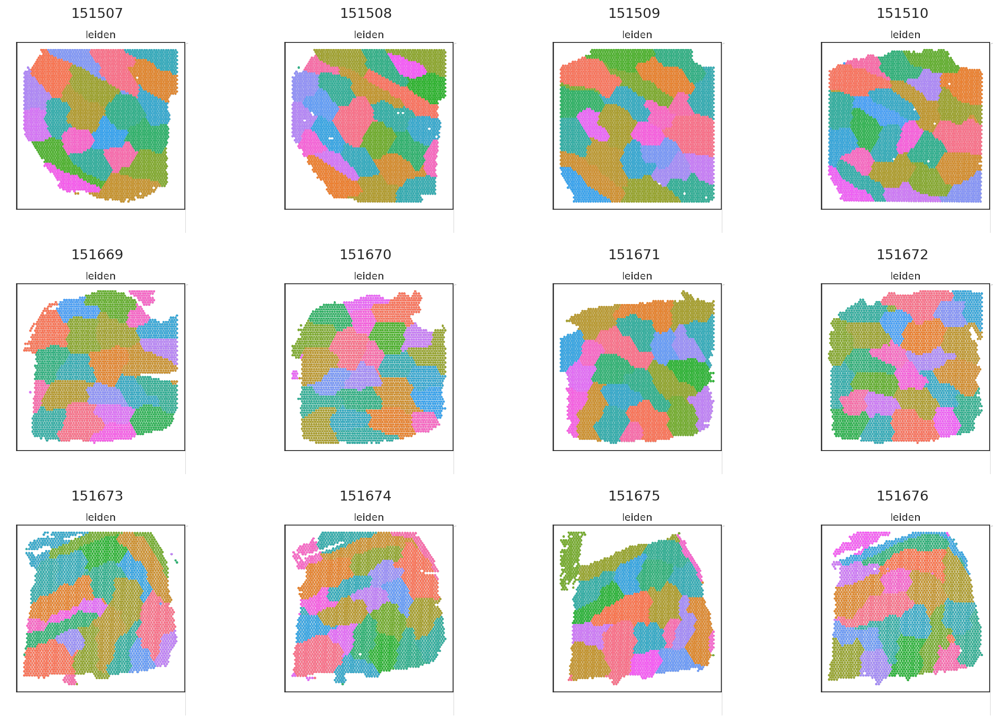

In [77]:
fig, axes = combine_images(
    spatialpca_figs_df, img_path_col='spatial_fig_png',
    x_min=50,
    x_max=550,
    y_min=20,# top
    y_max=700, # bottom
)
plt.show()

# SIMBA RNAseq only

In [82]:
sr_fn = "../results/00/simba_rna_only/run_simba_rna_only.output.tsv"
sr_figs_fn, sr_performance_fn = cluster_embeddings(sr_fn, cell_embedding_adata_fn='adata_C.h5ad')

100%|██████████| 12/12 [01:07<00:00,  5.61s/it]


Saving results in: ../results/00/simba_rna_only/UMAP_LEIDEN


100%|██████████| 12/12 [00:04<00:00,  2.68it/s]


In [85]:
sr_performance_fn

'../results/00/simba_rna_only/run_simba_rna_only.output.performance.tsv'

In [91]:
sr_figs_df = pd.read_csv(sr_figs_fn, sep='\t', index_col=0)

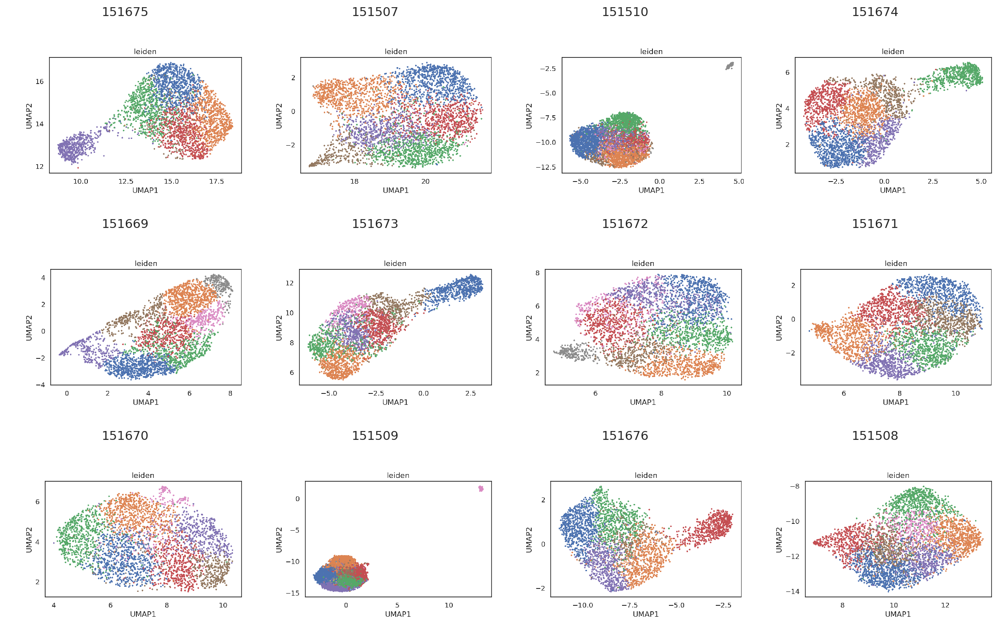

In [92]:
fig, axes = combine_images(
    sr_figs_df, img_path_col='umap_fig_png',
    x_min=80,
    x_max=950,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

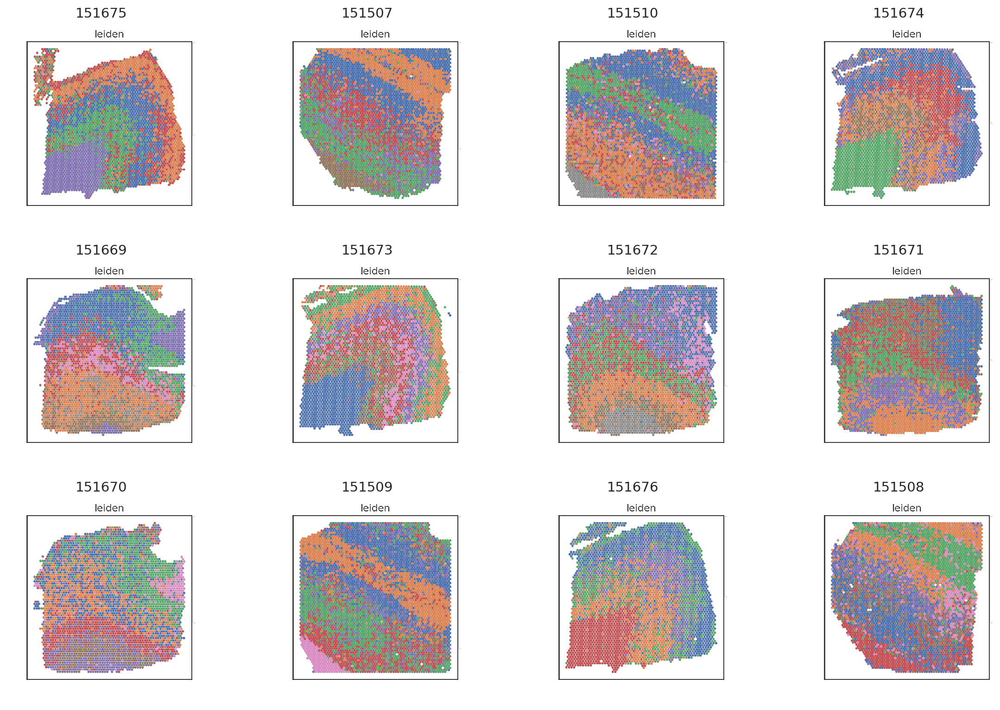

In [93]:
fig, axes = combine_images(
    sr_figs_df, img_path_col='spatial_fig_png',
    x_min=20,
    x_max=550,
    y_min=20,# top
    y_max=800, # bottom
)
plt.show()

# Spatial + RNA

## Mask, with Pearson scaling

In [45]:
ssr_mask_scaled_fn = "../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/run_simba_spatial_and_rna.output.tsv"
ssr_mask_scaled_figs_fn, ssr_mask_scaled_performance_fn = cluster_embeddings(ssr_mask_scaled_fn)

  0%|          | 0/12 [00:00<?, ?it/s]

100%|██████████| 12/12 [00:56<00:00,  4.71s/it]


Saving results in: ../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/UMAP_LEIDEN


100%|██████████| 12/12 [00:04<00:00,  2.83it/s]


In [86]:
ssr_mask_scaled_performance_fn

'../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/run_simba_spatial_and_rna.output.performance.tsv'

In [46]:
ssr_mask_scaled_figs_df = pd.read_csv(ssr_mask_scaled_figs_fn, sep='\t', index_col=0)

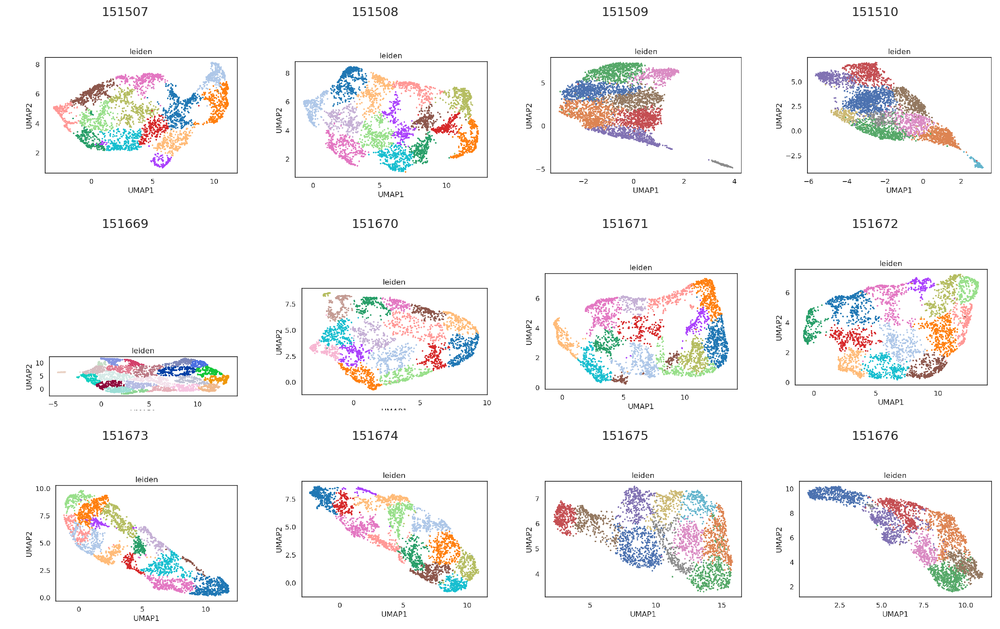

In [47]:
fig, axes = combine_images(
    ssr_mask_scaled_figs_df, img_path_col='umap_fig_png',
    x_min=80,
    x_max=950,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

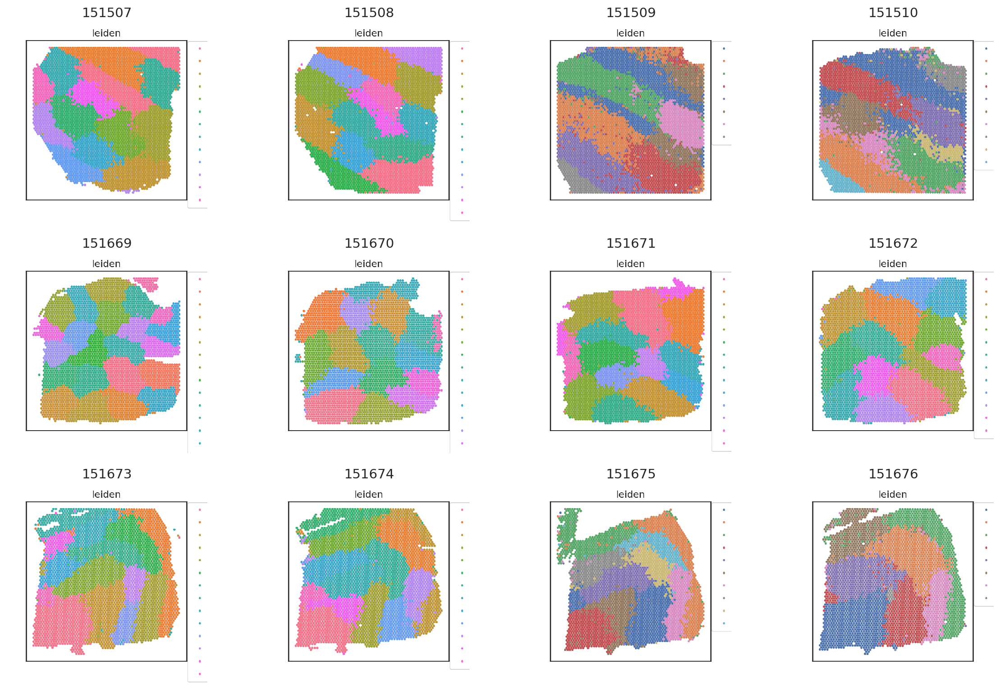

In [48]:
fig, axes = combine_images(
    ssr_mask_scaled_figs_df, img_path_col='spatial_fig_png',
    x_min=20,
    x_max=950,
    y_min=20,# top
    y_max=800, # bottom
)
plt.show()

## Mask, no pearson scaling

In [49]:
ssr_mask_fn = "../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/run_simba_spatial_only.output.tsv"
ssr_mask_figs_fn, ssr_mask_performance_fn = cluster_embeddings(ssr_mask_fn)

100%|██████████| 12/12 [00:56<00:00,  4.67s/it]


Saving results in: ../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/UMAP_LEIDEN


100%|██████████| 12/12 [00:04<00:00,  2.41it/s]


In [87]:
ssr_mask_performance_fn

'../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/run_simba_spatial_only.output.performance.tsv'

In [88]:
ssr_mask_figs_df = pd.read_csv(ssr_mask_figs_fn, sep='\t', index_col=0)

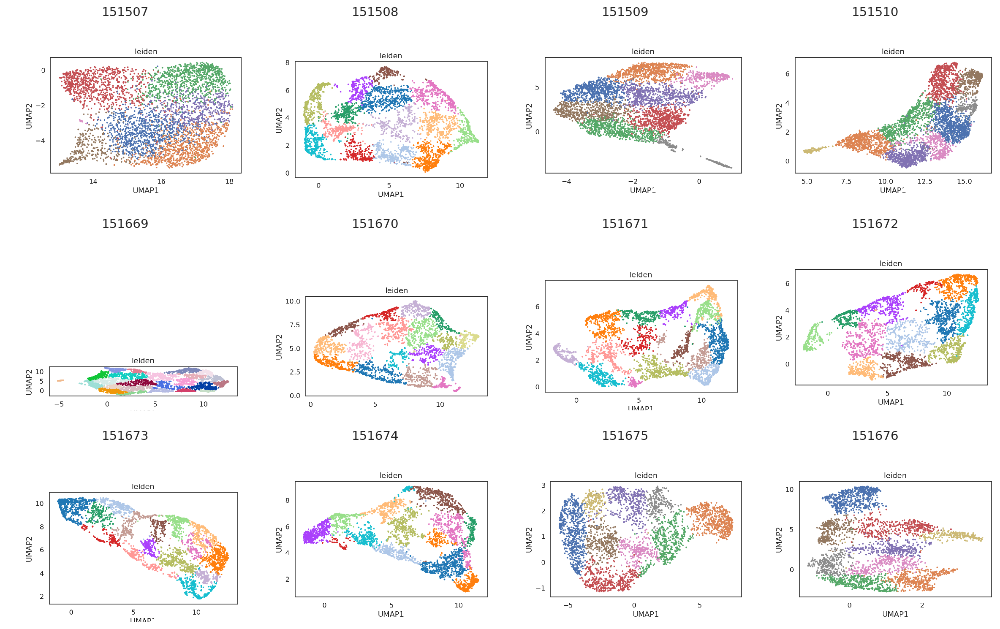

In [89]:
fig, axes = combine_images(
    ssr_mask_figs_df, img_path_col='umap_fig_png',
    x_min=80,
    x_max=950,
    y_min=50,# top
    y_max=700, # bottom
)
plt.show()

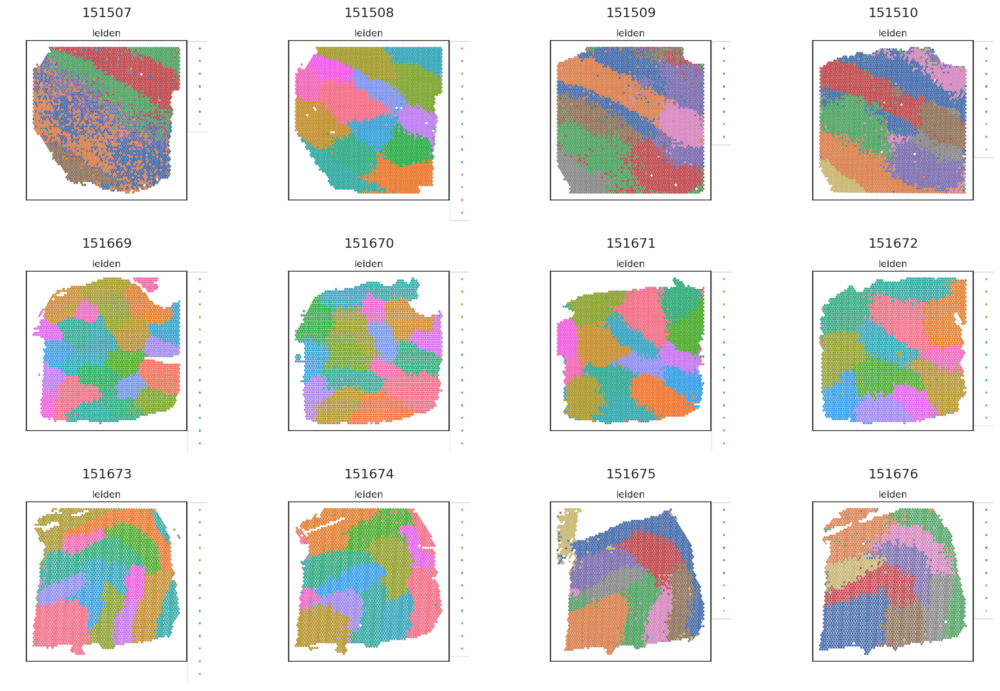

In [90]:
fig, axes = combine_images(
    ssr_mask_figs_df, img_path_col='spatial_fig_png',
    x_min=20,
    x_max=950,
    y_min=20,# top
    y_max=800, # bottom
)
plt.show()

## RBF, Pearson scaling

In [ ]:
ssr_rbf_scaled_fn = "../results/00/simba_spatial_and_rna/rbf_e5_sT_w1.0/run_simba_spatial_and_rna.output.tsv"
ssr_rbf_scaled_figs_fn, ssr_rbf_scaled_performance_fn = cluster_embeddings(ssr_rbf_scaled_fn)

## RBF, no Pearson scaling

In [101]:
ssr_rbf_fn = "../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/run_simba_spatial_only.output.tsv"
ssr_rbf_figs_fn, ssr_rbf_performance_fn = cluster_embeddings(ssr_rbf_fn)

100%|██████████| 12/12 [01:06<00:00,  5.52s/it]


Saving results in: ../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/UMAP_LEIDEN


100%|██████████| 12/12 [00:05<00:00,  2.18it/s]


In [102]:
ssr_rbf_performance_fn

'../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/run_simba_spatial_only.output.performance.tsv'

## Gaussian, no scaling

In [ ]:
ssr_gaussian_fn = "../results/00/simba_spatial_and_rna/gaussian_e3_sF_w1.0/run_simba_spatial_only.output.tsv"
ssr_gaussian_figs_fn, ssr_gaussian_performance_fn = cluster_embeddings(ssr_gaussian_fn)

In [ ]:
ssr_gaussian_performance_fn

## Gaussian, with pearson scaling

In [ ]:
ssr_gaussian_scaled_fn = "../results/00/simba_spatial_and_rna/gaussian_e3_sT_w1.0/run_simba_spatial_and_rna.output.tsv"
ssr_gaussian_scaled_figs_fn, ssr_gaussian_scaled_performance_fn = cluster_embeddings(ssr_gaussian_scaled_fn)

In [ ]:
ssr_gaussian_scaled_performance_fn

# Aggregate performance metrics

In [103]:
pca_performance_fn = '../results/00/pca_rna/run_pca.output.performance.tsv'
pca_performance_df = pd.read_csv(pca_performance_fn, sep='\t', index_col=0)
spatialPCA_performance_fn = '../results/00/spatialpca/spatialpca_adata_py.performance.tsv'
spatialPCA_performance_df = pd.read_csv(spatialPCA_performance_fn, sep='\t', index_col=0)
sr_performance_fn = '../results/00/simba_rna_only/run_simba_rna_only.output.performance.tsv'
sr_performance_df = pd.read_csv(sr_performance_fn, sep='\t', index_col=0)

ssr_mask_scaled_performance_fn = '../results/00/simba_spatial_and_rna/mask_r500_sT_w1.0/run_simba_spatial_and_rna.output.performance.tsv'
ssr_mask_scaled_performance_df = pd.read_csv(ssr_mask_scaled_performance_fn, sep='\t', index_col=0)

ssr_mask_performance_fn = '../results/00/simba_spatial_and_rna/mask_r500_sF_w1.0/run_simba_spatial_only.output.performance.tsv'
ssr_mask_performance_df = pd.read_csv(ssr_mask_performance_fn, sep='\t', index_col=0)

ssr_rbf_performance_fn = '../results/00/simba_spatial_and_rna/rbf_e5_sF_w1.0/run_simba_spatial_only.output.performance.tsv'
ssr_rbf_performance_df = pd.read_csv(ssr_rbf_performance_fn, sep='\t', index_col=0)

In [104]:
pca_performance_df['method'] = 'PCA'
sr_performance_df['method'] = 'SIMBA_RNA'
spatialPCA_performance_df['method'] = 'SpatialPCA'
ssr_mask_performance_df['method'] = 'SIMBA_SPATIAL_RNA_MASK'
ssr_mask_scaled_performance_df['method'] = 'SIMBA_SPATIAL_RNA_MASK_PEARSON'
ssr_rbf_performance_df['method'] = 'SIMBA_SPATIAL_RNA_RBF'

In [105]:
performance_df = pd.concat([
    pca_performance_df, sr_performance_df, 
    spatialPCA_performance_df, ssr_mask_performance_df, ssr_rbf_performance_df,
    ssr_mask_scaled_performance_df
])

In [106]:
performance_df.columns

Index(['silhoutte', 'ARI', 'NMI', 'leiden_adata_fn', 'method'], dtype='object')

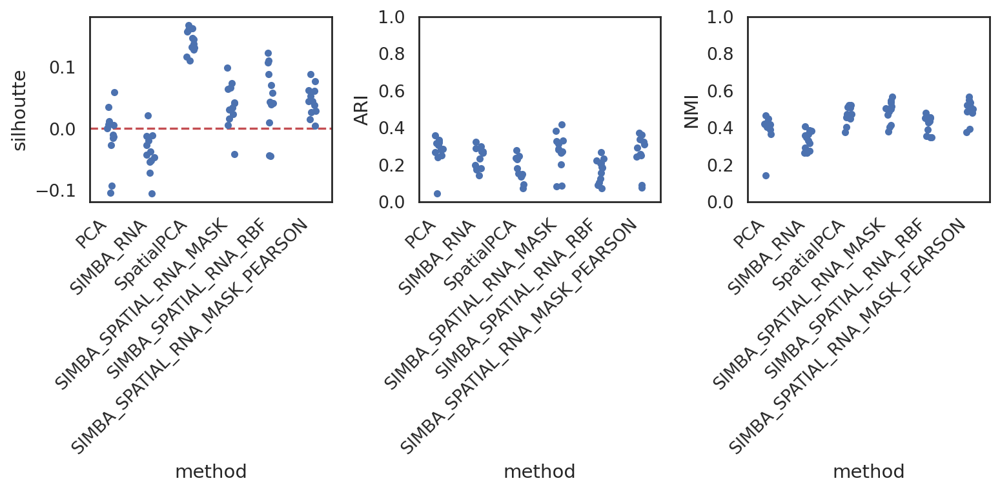

In [107]:
fig, axes = plt.subplots(1, 3, figsize=(10, 5), sharex=True)

for i, measure in enumerate(['silhoutte', 'ARI', 'NMI']):
    sns.stripplot(performance_df.reset_index(), x='method', y=measure, ax=axes[i])

    if measure in ['ARI', 'NMI']:
        axes[i].set_ylim(0, 1)
    if measure == 'silhoutte':
        axes[i].axhline(0, c='r', linestyle='--')

    for tick in axes[i].get_xticklabels():
        tick.set_rotation(45)
        tick.set_horizontalalignment('right')

plt.tight_layout()
plt.show()
